# SMAI Assignment-5, Q-2, KDE

In [1]:
import pandas as pd
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import norm, triang, uniform

In [2]:
def visualize_bboxes(img):
  img_2 = img.copy()
  for index, rows in df.iterrows():
    top_left = (int(rows['Top-Left'].split(',')[0][1:]),int(rows['Top-Left'].split(',')[1][:-1]))
    bottom_right = (int(rows['Bottom-Right'].split(',')[0][1:]),int(rows['Bottom-Right'].split(',')[1][:-1]))
    # print(top_left)
    cv2.rectangle(img_2, top_left, bottom_right, (255, 0, 0), 2)
  plt.figure(figsize=(20, 14))
  plt.imshow(img_2)
  plt.show()

In [5]:
def make_connections(image,euclidean):

  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  image_with_boxes = image_rgb.copy()

  for index, row in euclidean.iterrows():
      left = int(row['Left-Edge-Center'][0])
      right = int(row['Right-Edge-Center'][0])
      top = int(row['Top-Edge-Center'][1])
      bottom = int(row['Bottom-Edge-Center'][1])
      box_id = int(row['Id'])

      width = right - left
      height = bottom - top

      top_left = (left, top)
      bottom_right = (right, bottom)

      cv2.rectangle(image_with_boxes, top_left, bottom_right, (255, 0, 0), 2)

      label_position = (left, top - 10)
      cv2.putText(image_with_boxes, str(box_id), label_position, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1)

      top_adjacent_id = int(row['Top_Box'][1])
      bottom_adjacent_id = int(row['Bottom_Box'][1])
      left_adjacent_id = int(row['Left_Box'][1])
      right_adjacent_id = int(row['Right_Box'][1])

      if top_adjacent_id != 0:
          top_adjacent_row = euclidean[euclidean['Id'] == top_adjacent_id].iloc[0]
          top_adjacent_center = int(top_adjacent_row['Bottom-Edge-Center'][0]) , int(top_adjacent_row['Bottom-Edge-Center'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(top)), top_adjacent_center, (0, 255, 0), 2)

      if bottom_adjacent_id != 0:
          bottom_adjacent_row = euclidean[euclidean['Id'] == bottom_adjacent_id].iloc[0]
          bottom_adjacent_center = int(bottom_adjacent_row['Top-Edge-Center'][0]) , int(bottom_adjacent_row['Top-Edge-Center'][1])
          cv2.line(image_with_boxes, (int(left) + width // 2, int(bottom)), (int(bottom_adjacent_center[0]), int(bottom_adjacent_center[1])), (0, 255, 0), 2)

      if left_adjacent_id != 0:
          left_adjacent_row = euclidean[euclidean['Id'] == left_adjacent_id].iloc[0]
          left_adjacent_center = int(left_adjacent_row['Right-Edge-Center'][0]) , int(left_adjacent_row['Right-Edge-Center'][1])
          cv2.line(image_with_boxes, (int(left), int(top) + height // 2), (int(left_adjacent_center[0]), int(left_adjacent_center[1])), (0, 255, 0), 2)

      if right_adjacent_id != 0:
          right_adjacent_row = euclidean[euclidean['Id'] == right_adjacent_id].iloc[0]
          right_adjacent_center = int(right_adjacent_row['Left-Edge-Center'][0]) , int(right_adjacent_row['Left-Edge-Center'][1])
          cv2.line(image_with_boxes, (int(right), int(top) + height // 2), (int(right_adjacent_center[0]), int(right_adjacent_center[1])), (0, 255, 0), 2)

  return image_with_boxes

## 2.2 Task-1 : (20)<br>
Implement Kernel Density Estimation (KDE). Your KDE should include the
following functions<br>
• allows selection from the following kernels: box, gaussian, triangular<br>
• fit data<br>
• select appropriate bandwidth using the pseudo-likelihood method<br>
• evaluate the density given an input x<br>
• visualize the data and the estimated pdf. For this you can assume that
the function will be used only when input dataset is 1-D or 2-D.

Random data kernel density estimation visulization to check the model.


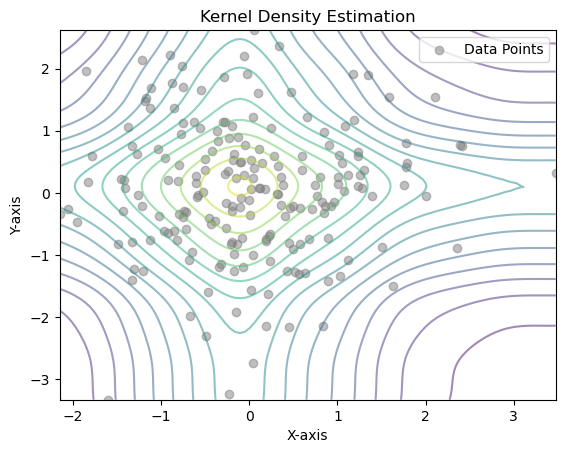

In [7]:
class KDE:
    def __init__(self, kernel='gaussian'):
        self.kernel = kernel
        self.data = None
        self.bandwidth = None

    def fit(self, data):
        self.data = np.array(data)
        self._select_bandwidth()

    def _select_bandwidth(self):
        if self.kernel == 'gaussian':
            self.bandwidth = self._bandwidth_silverman()
        elif self.kernel == 'box':
            self.bandwidth = self._bandwidth_box()
        elif self.kernel == 'triangular':
            self.bandwidth = self._bandwidth_triangular()
        else:
            print("self.kernel:",self.kernel)
            raise ValueError("Unsupported kernel type. Use 'gaussian', 'box', or 'triangular'.")

    def _bandwidth_silverman(self):
        n = len(self.data)
        if n == 1:
            return 1.0
        else:
            std_dev = np.std(self.data)
            return (4 / (3 * n)) ** 0.2 * std_dev

    def _bandwidth_box(self):
        iqr = np.percentile(self.data, 75) - np.percentile(self.data, 25)
        return 0.9 * min(np.std(self.data), iqr / 1.34) * (len(self.data) ** (-1 / 5))

    def _bandwidth_triangular(self):
        iqr = np.percentile(self.data, 75) - np.percentile(self.data, 25)
        return 1.06 * min(np.std(self.data), iqr / 1.34) * (len(self.data) ** (-1 / 5))

    def evaluate_density(self, x):
        if self.data is None:
            raise ValueError("Fit data before evaluating density.")
        return np.mean(self._kernel_function(x - self.data[:, None]))

    def _kernel_function(self, x):
        if self.kernel == 'gaussian':
            return norm.pdf(x / self.bandwidth) / self.bandwidth
        elif self.kernel == 'box':
            return 0.5 * (abs(x / self.bandwidth) <= 1) / self.bandwidth
        elif self.kernel == 'triangular':
            return triang.pdf(x / self.bandwidth,0.5) / self.bandwidth
        else:
            raise ValueError("Unsupported kernel type. Use 'gaussian', 'box', or 'triangular'.")

    def visualize(self):
        if len(self.data.shape) == 1:
            self._visualize_1d()
        elif len(self.data.shape) == 2:
            self._visualize_2d()
        else:
            raise ValueError("Unsupported dimensionality. Only 1-D and 2-D data are supported.")

    def _visualize_1d(self):
        plt.hist(self.data, bins=30, density=True, alpha=0.5, color='gray', label='Data Histogram')

        x_values = np.linspace(min(self.data), max(self.data), 1000)
        y_values = [self.evaluate_density(x) for x in x_values]
        plt.plot(x_values, y_values, label=f'{self.kernel.capitalize()} KDE')

        plt.title('Kernel Density Estimation')
        plt.xlabel('Data Values')
        plt.ylabel('Density')
        plt.legend()
        plt.show()

    def _visualize_2d(self):
        plt.scatter(self.data[:, 0], self.data[:, 1], alpha=0.5, label='Data Points', color='gray')

        x, y = np.meshgrid(np.linspace(min(self.data[:, 0]), max(self.data[:, 0]), 100),
                           np.linspace(min(self.data[:, 1]), max(self.data[:, 1]), 100))
        positions = np.vstack([x.ravel(), y.ravel()])
        values = np.array([self.evaluate_density(pos) for pos in positions.T])
        values = values.reshape(100, 100)

        plt.contour(x, y, values, cmap='viridis', levels=15, alpha=0.5)

        plt.title('Kernel Density Estimation')
        plt.xlabel('X-axis')
        plt.ylabel('Y-axis')
        plt.legend()
        plt.show()
print("Random data kernel density estimation visulization to check the model.")
data = np.random.randn(200, 2)  # Example 2D data
kde = KDE(kernel='gaussian')
kde.fit(data)
kde.visualize()

## 2.3 Task-2 : (80)
#### Problem 4.2 from Assignment 2

In [8]:
df = pd.read_csv("SMAI - AQ2/CSV/TLBR_68.csv")
img = cv2.imread('SMAI - AQ2/images/68.jpg')

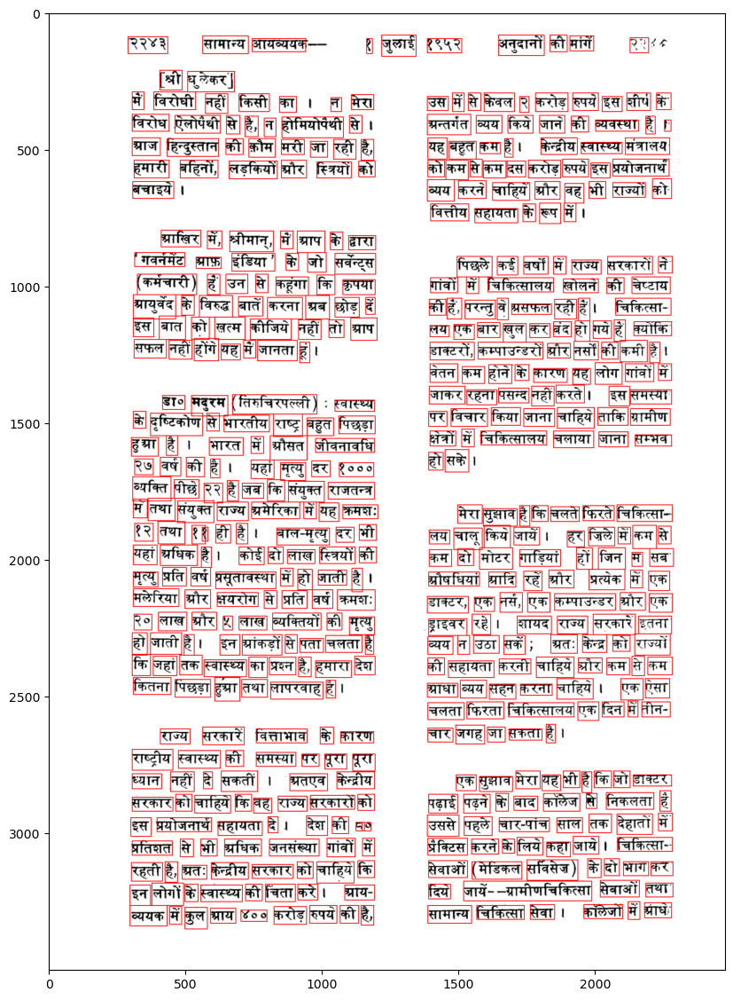

In [15]:
visualize_bboxes(img)

### Generate euclidean dataframe

In [15]:
np.absolute([10,-11])

array([10, 11])

In [17]:
def get_nearest_neighbors(euc_df, current_row, current_edge_center, edge_center_column, threshold):
        current_id = current_row['Id']+1

        distances = []

        for index, row in euc_df.iterrows():
            if row['Id'] != current_id:
                distance = np.absolute(euclidean_distance(current_edge_center, row[edge_center_column]))
                if distance <= threshold:
                    distances.append((distance, row['Id']))

        distances.sort(key=lambda x: x[0])

        if len(distances) >= 2:
            return [distances[1][1],distances[0][1]]
        elif len(distances) == 1:
            return [0,distances[0][1]]
        else:
            return [0, 0]

def euclidean_distance(point1, point2):
    return np.sqrt((point1[0] - point2[0]) ** 2 + (point1[1] - point2[1]) ** 2)

def generate_euclidean_dataframe(df_csv, horizontal_threshold, vertical_threshold):
   
    df = pd.DataFrame(df_csv)
    top_edge_center = []
    bottom_edge_center = []
    right_edge_center = []
    left_edge_center = []
    
    euclidean_data = []

    for index, row in df.iterrows():
        top_left = (int(row['Top-Left'].split(',')[0][1:]),int(row['Top-Left'].split(',')[1][:-1]))
        bottom_right = (int(row['Bottom-Right'].split(',')[0][1:]),int(row['Bottom-Right'].split(',')[1][:-1]))
        
        top_edge_center = [(top_left[0] + bottom_right[0]) / 2, top_left[1]]
        bottom_edge_center = [(top_left[0] + bottom_right[0]) / 2, bottom_right[1]]
        right_edge_center = [bottom_right[0], (top_left[1] + bottom_right[1]) / 2]
        left_edge_center = [top_left[0], (top_left[1] + bottom_right[1]) / 2]
        euclidean_df = pd.DataFrame(euclidean_data)

        euclidean_row = {
            'Id': row['Id'] + 1 ,
            'Top-Left': top_left,
            'Bottom-Right': bottom_right,
            'Top-Edge-Center': top_edge_center,
            'Bottom-Edge-Center': bottom_edge_center,
            'Right-Edge-Center': right_edge_center,
            'Left-Edge-Center': left_edge_center,
            'Top_Box': get_nearest_neighbors(euclidean_df, row, top_edge_center, 'Bottom-Edge-Center', vertical_threshold),
            'Bottom_Box': [0,0],
            # 'Bottom_Box': get_nearest_neighbors(euclidean_df, row, bottom_edge_center, 'Top-Edge-Center', vertical_threshold),
            # 'Right_Box': get_nearest_neighbors(euclidean_df, row, right_edge_center, 'Left-Edge-Center', horizontal_threshold),
            'Right_Box':[0,0],
            'Left_Box': get_nearest_neighbors(euclidean_df, row, left_edge_center, 'Right-Edge-Center', horizontal_threshold),
        }

        euclidean_data.append(euclidean_row)
    return pd.DataFrame(euclidean_data)

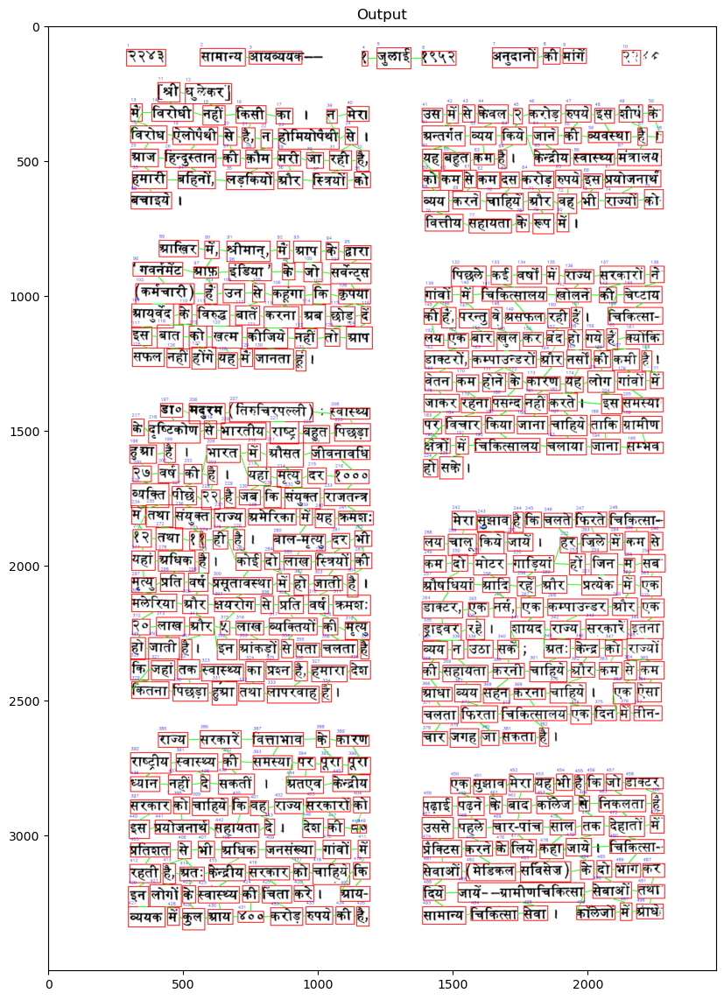

In [17]:
horizontal_threshold = 100
vertical_threshold = 60 
euclidean_df = generate_euclidean_dataframe(df, horizontal_threshold, vertical_threshold)
plt.figure(figsize=(20, 14))
plt.imshow(make_connections(img,euclidean_df))
plt.title("Output")
plt.show()

### KDE implementation

In [42]:
def calculate_kde_threshold(data,kernel='gaussian',horizontal_t = False):
    data = np.array(data)
    kde = KDE(kernel=kernel)
    kde.fit(data)
    kde.visualize()

    x_eval = np.linspace(np.min(data), np.max(data),100)
    log_density = [kde.evaluate_density(x) for x in x_eval]

    threshold_index = np.argmax(log_density)
    if(horizontal_t == True):
        log_density_n = log_density[threshold_index:]
        for i,den in enumerate(log_density_n):
            if den < (0.96*log_density[threshold_index]):
                threshold_index_n = i
                break
        threshold = x_eval[threshold_index_n]
        return threshold
    else:
        threshold = x_eval[threshold_index]
        return threshold


* The Hyperparameter is done based on the bandwidth in KDE.   
* In the KDE class i have defined the different kernels which will decide the bandwidth. 
* So, the different kernal evantually gives different bandwidth for hyper parameters.

----------------------Image-29-------------------------
Hyper parameter: gaussian


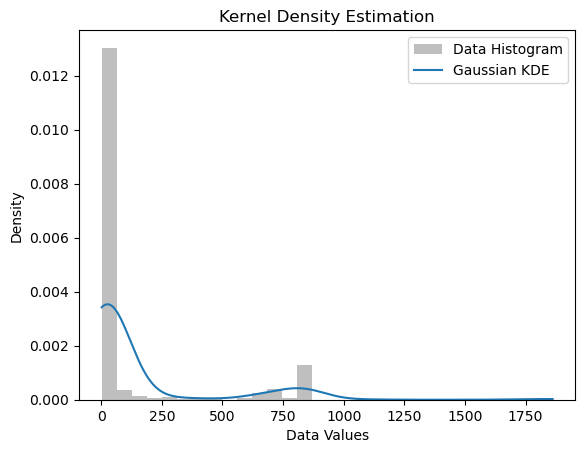

horizontal_threshold value: 39.55555555555556


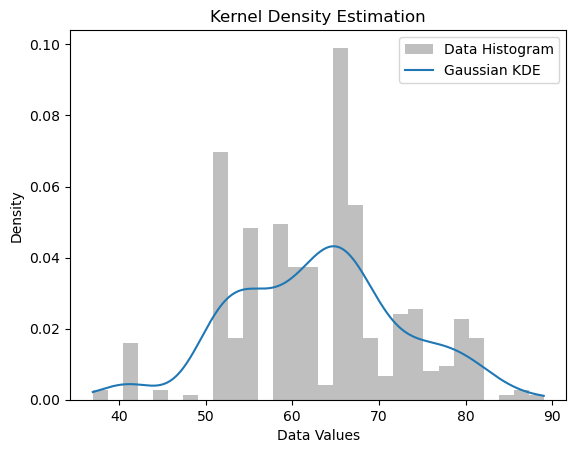

vertical_threshold value: 64.83838383838383


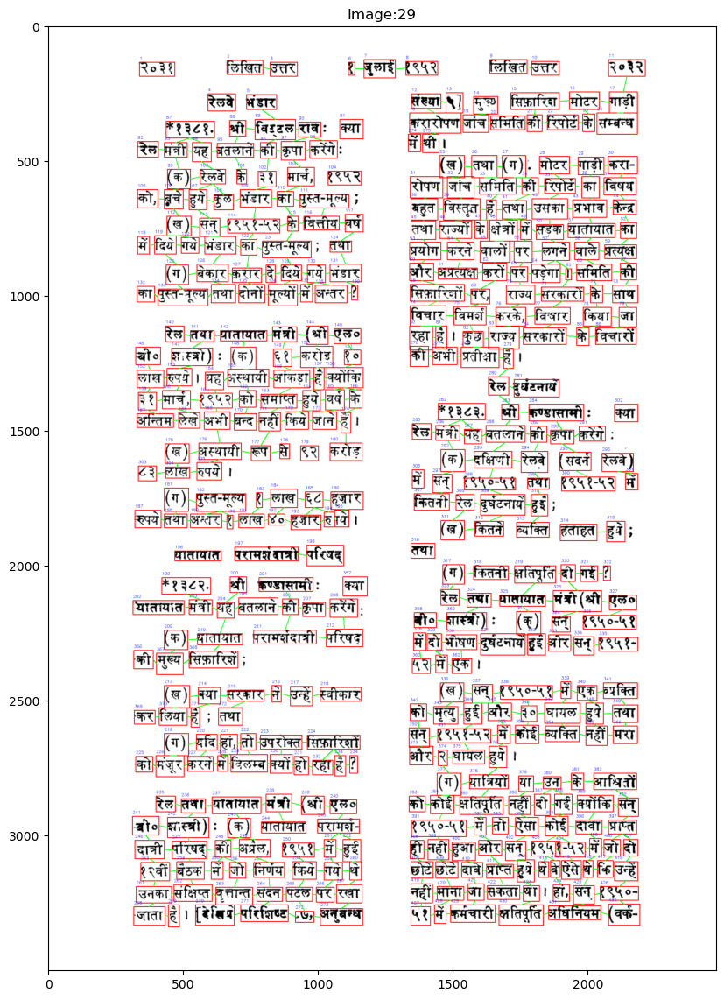

Hyper parameter: box


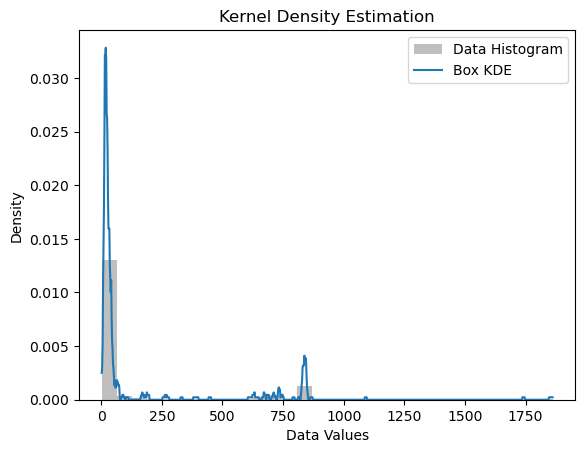

horizontal_threshold value: 20.77777777777778


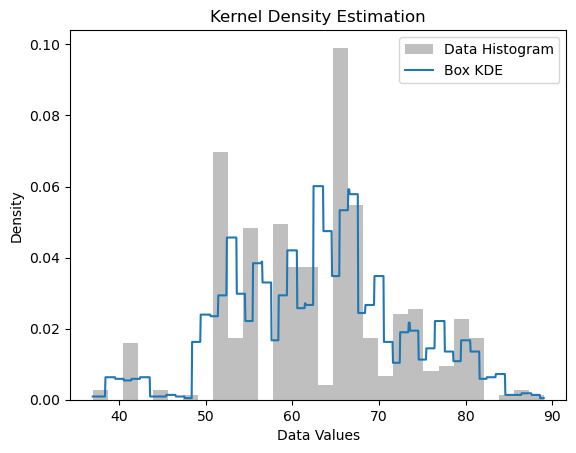

vertical_threshold value: 62.737373737373744


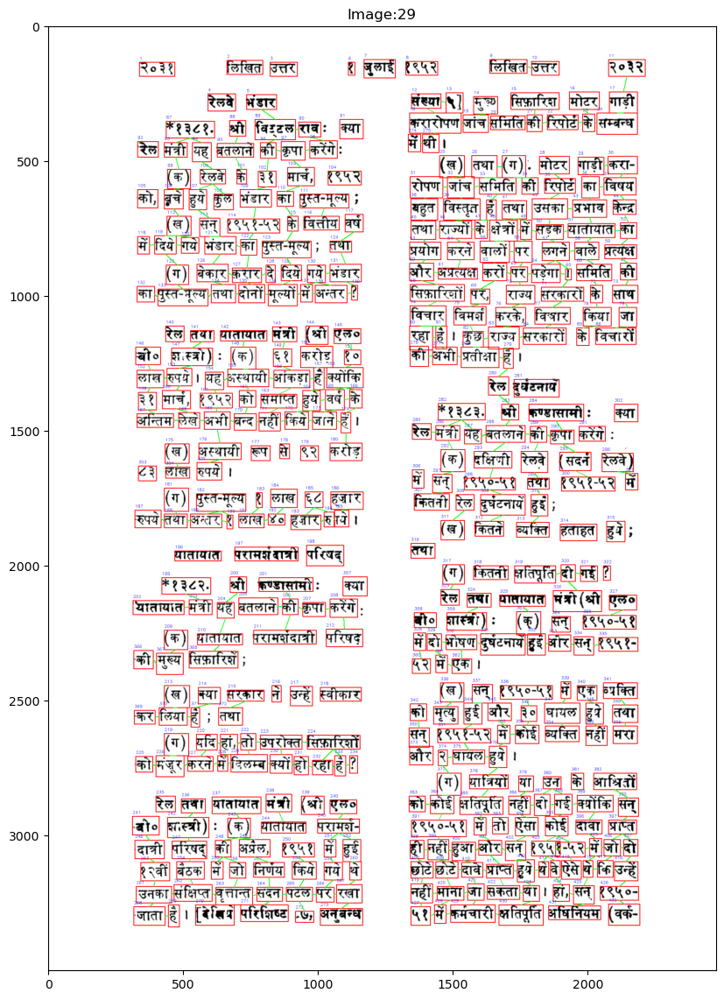

Hyper parameter: triangular


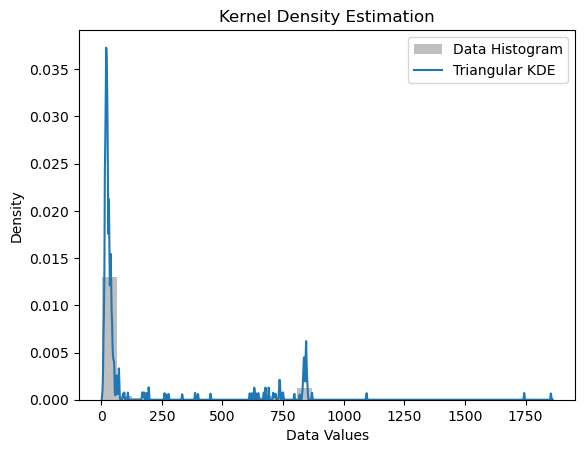

horizontal_threshold value: 20.77777777777778


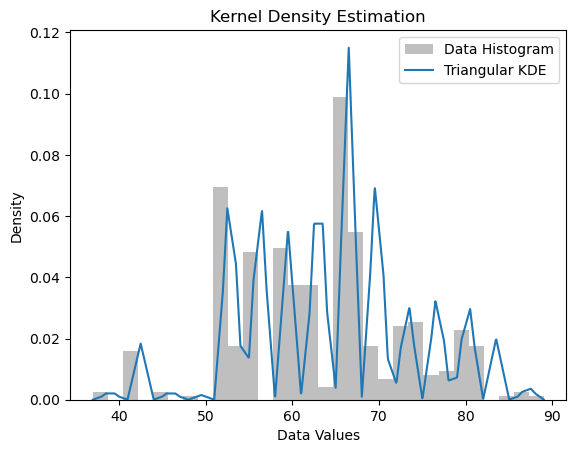

vertical_threshold value: 66.41414141414143


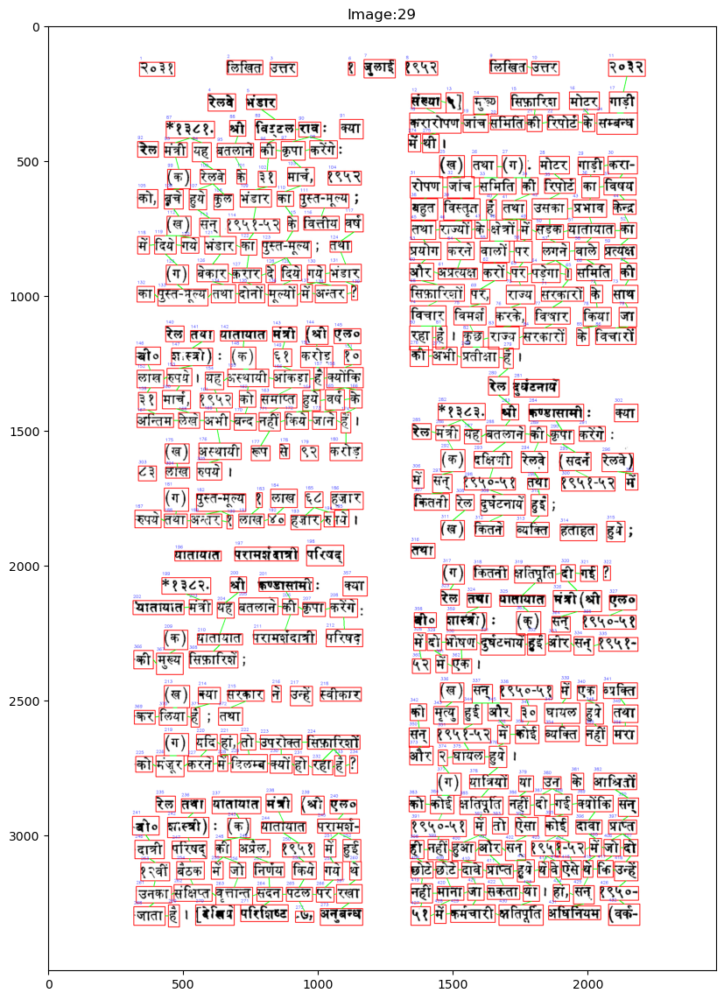

----------------------Image-68-------------------------
Hyper parameter: gaussian


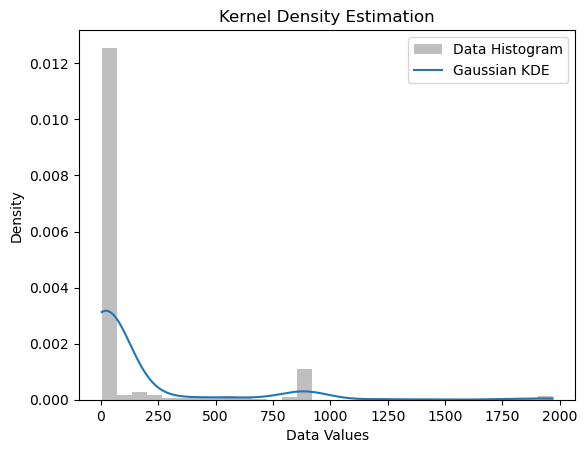

horizontal_threshold value: 42.717171717171716


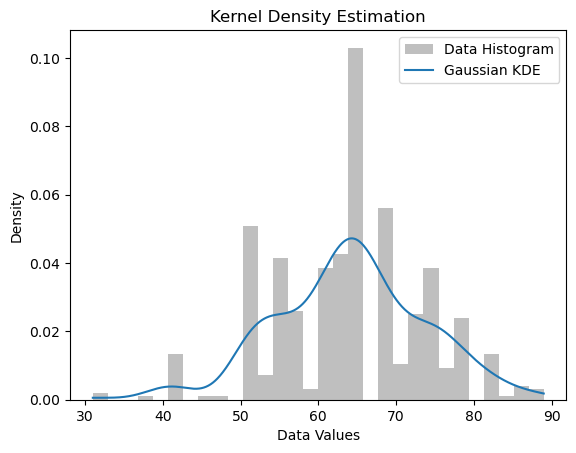

vertical_threshold value: 64.39393939393939


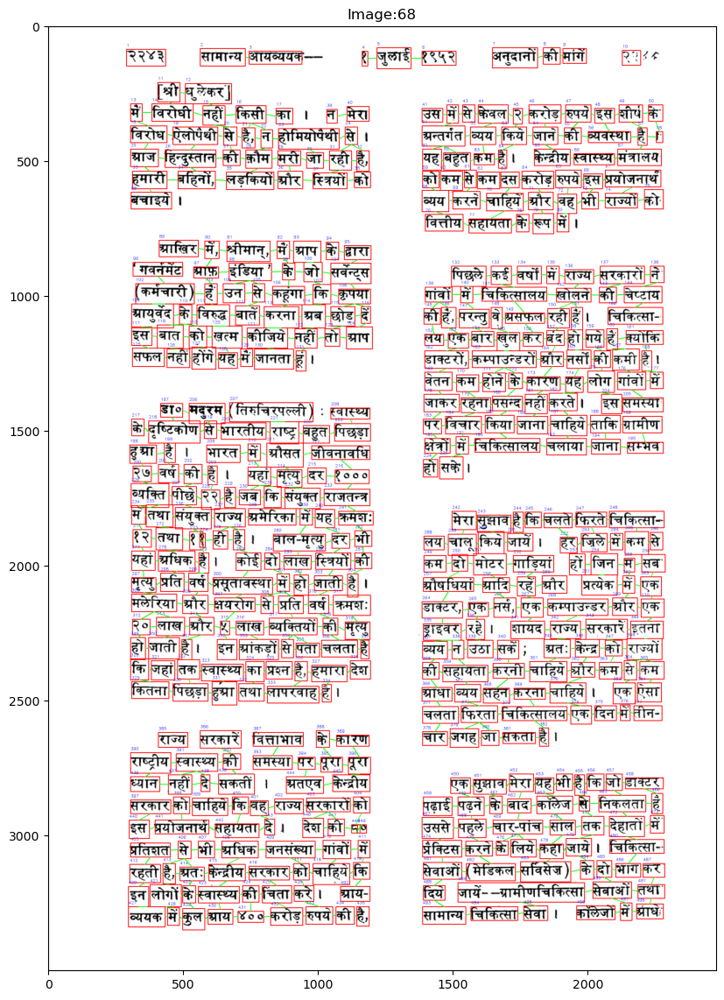

Hyper parameter: box


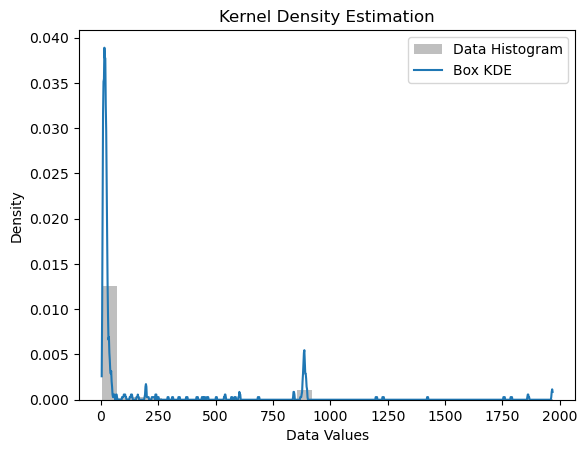

horizontal_threshold value: 22.858585858585858


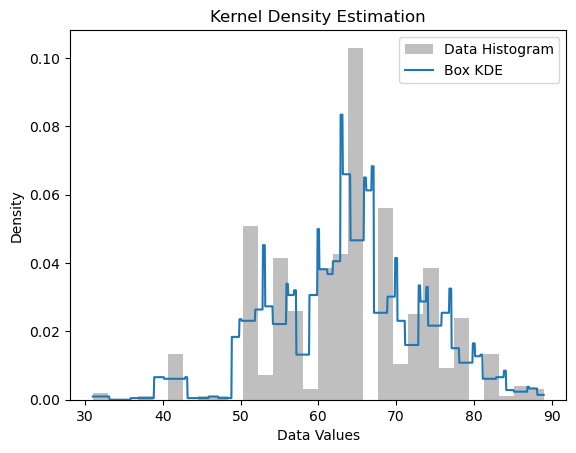

vertical_threshold value: 63.22222222222222


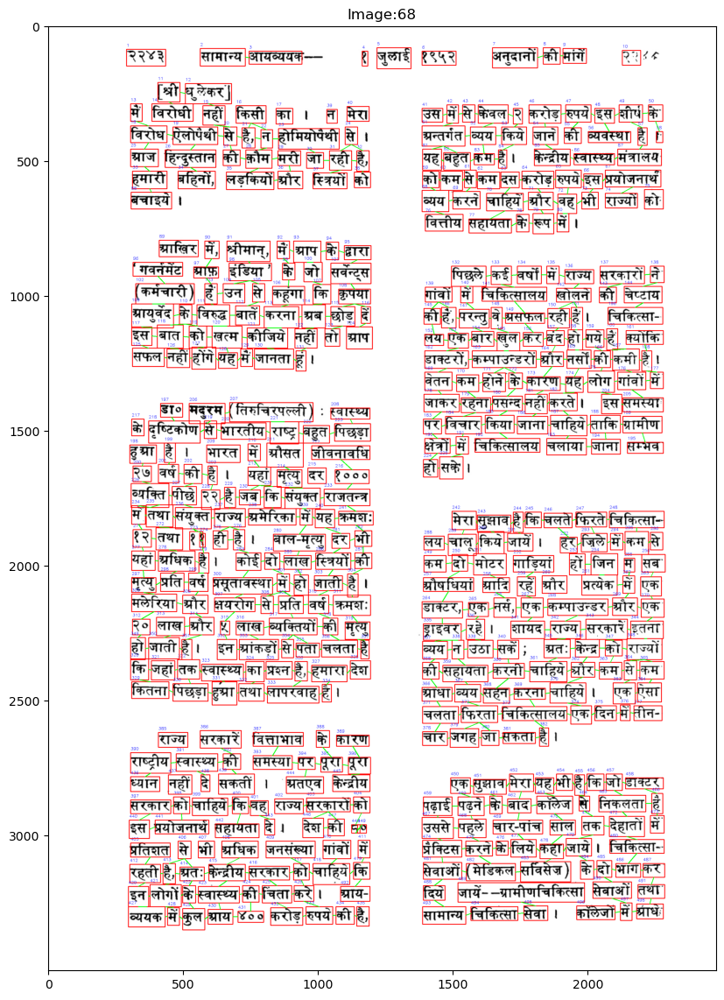

Hyper parameter: triangular


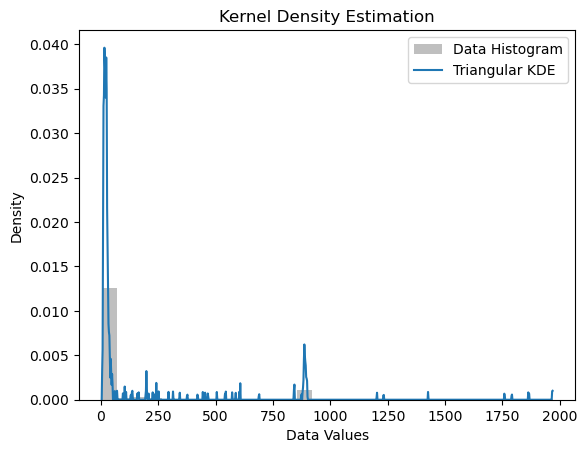

horizontal_threshold value: 22.858585858585858


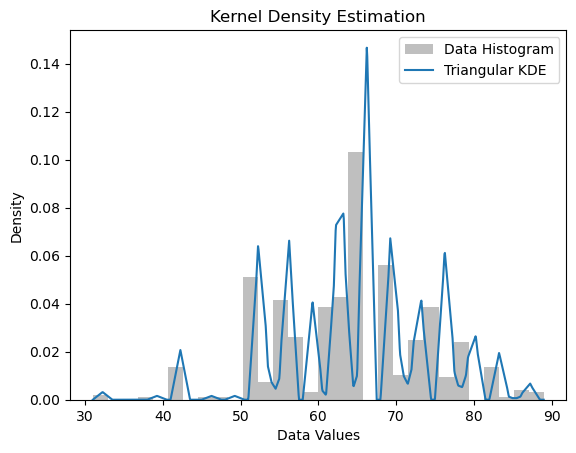

vertical_threshold value: 66.15151515151516


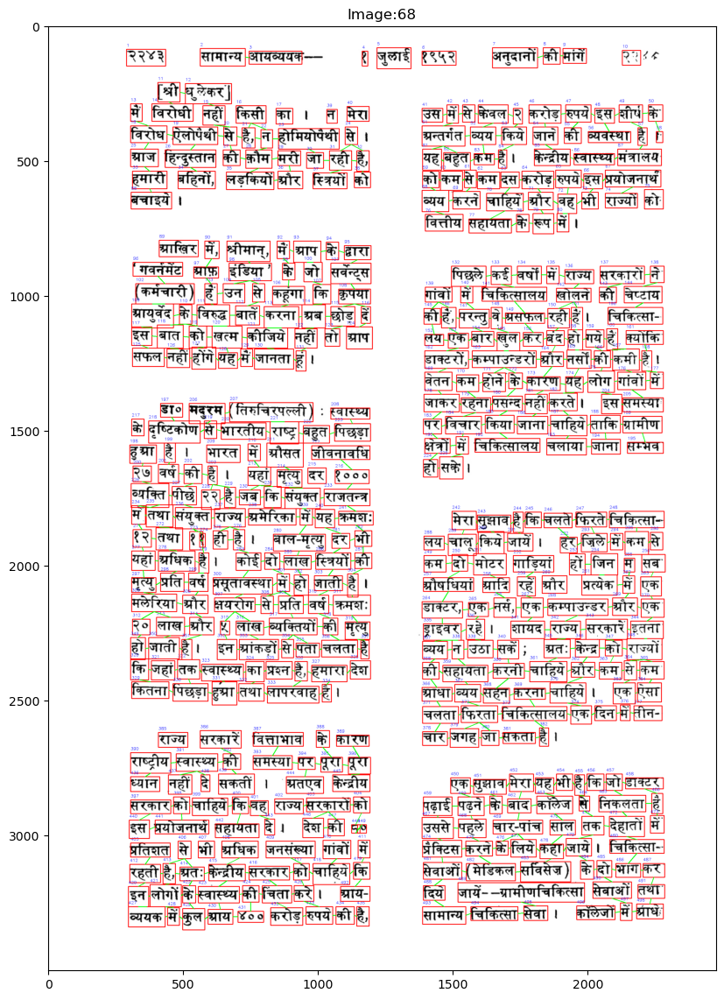

----------------------Image-145-------------------------
Hyper parameter: gaussian


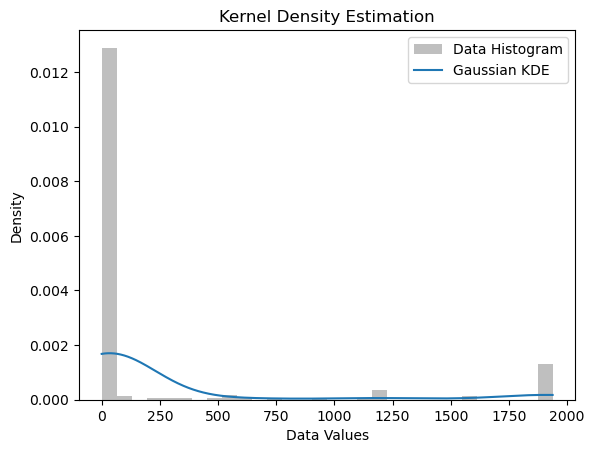

horizontal_threshold value: 58.72727272727272


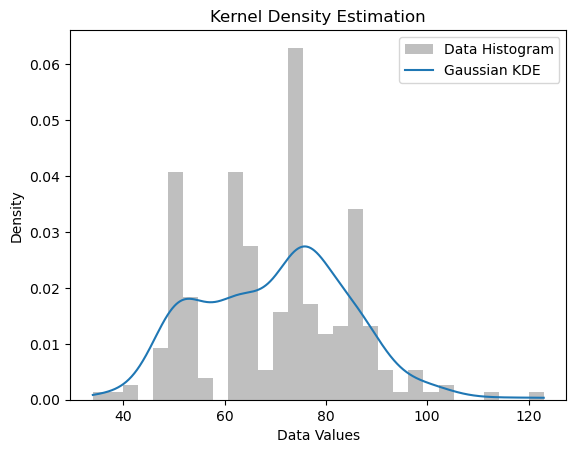

vertical_threshold value: 76.25252525252526


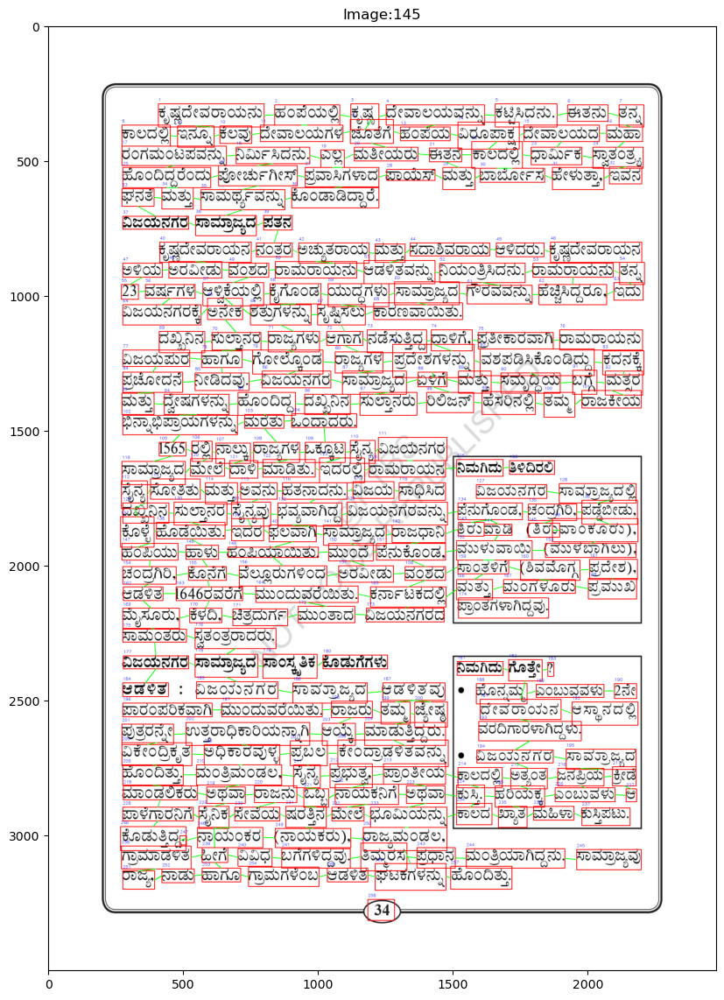

Hyper parameter: box


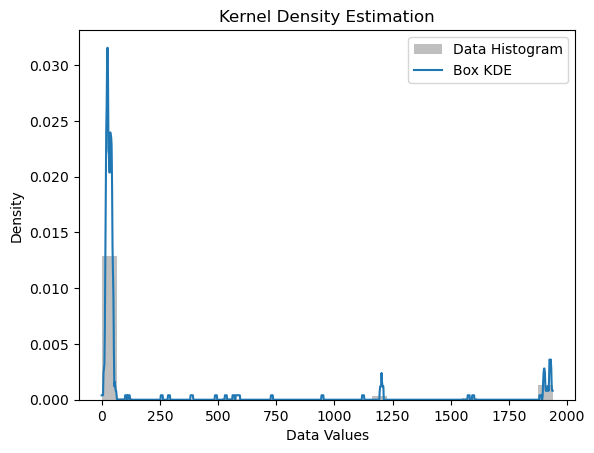

horizontal_threshold value: 39.15151515151515


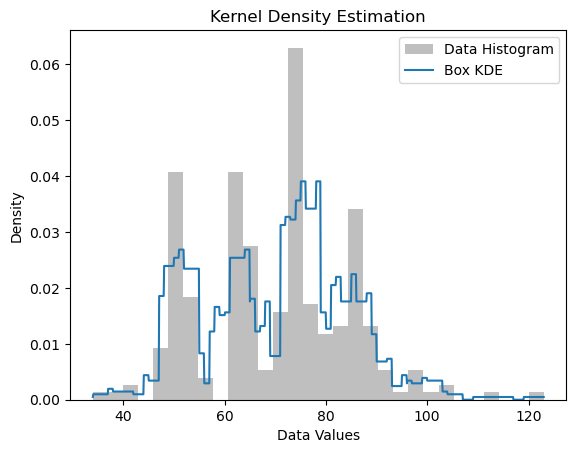

vertical_threshold value: 75.35353535353536


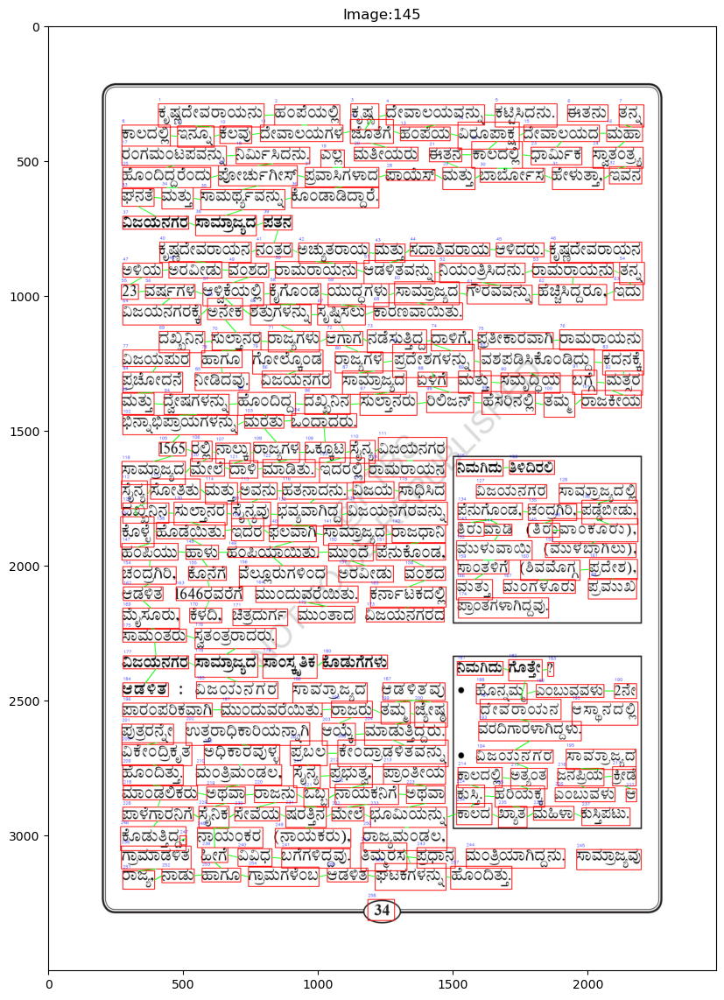

Hyper parameter: triangular


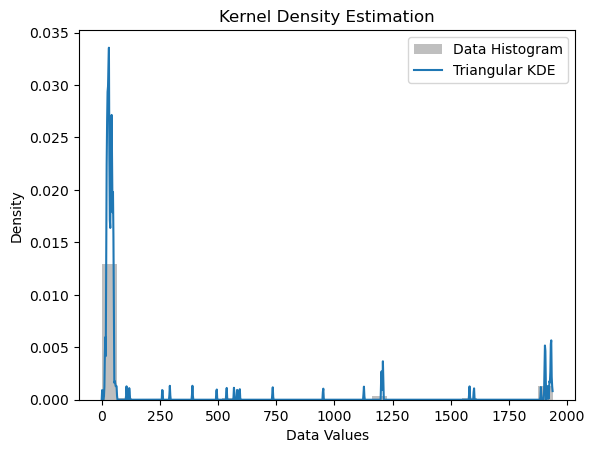

horizontal_threshold value: 19.575757575757574


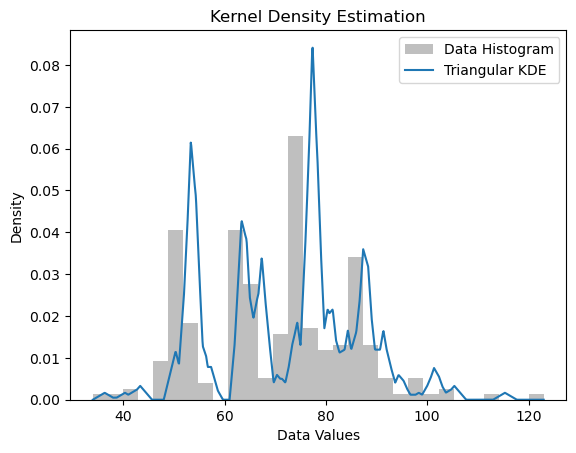

vertical_threshold value: 77.15151515151516


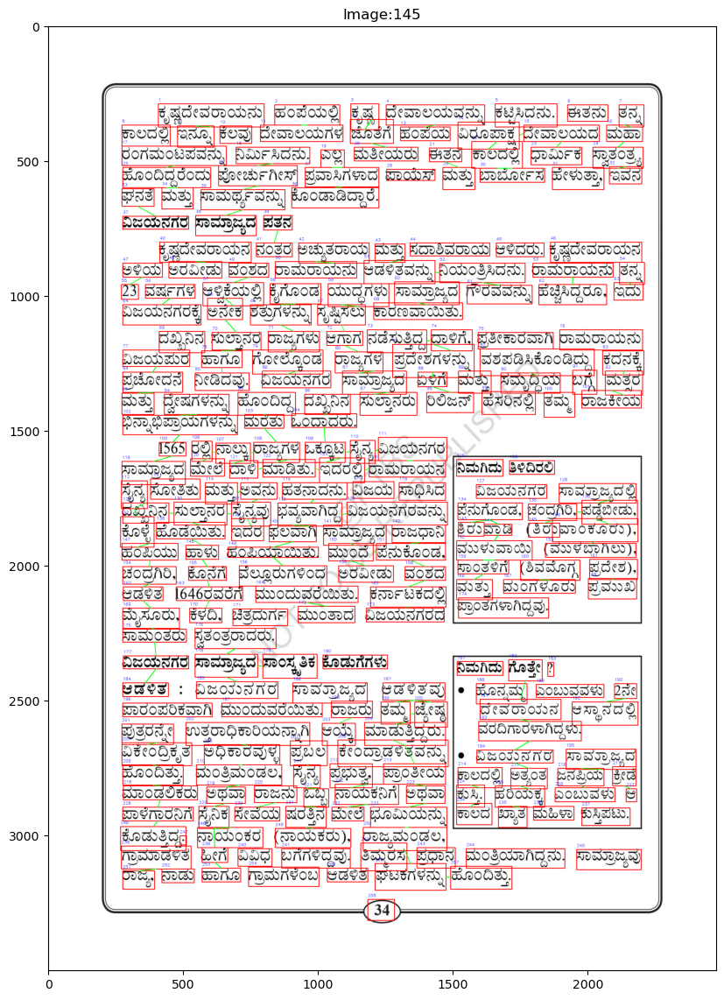

----------------------Image-201-------------------------
Hyper parameter: gaussian


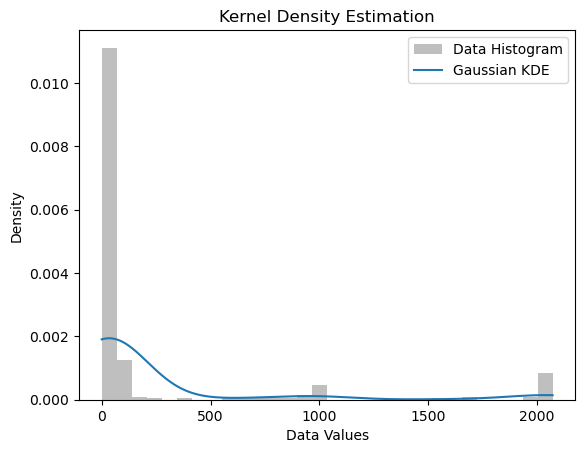

horizontal_threshold value: 62.787878787878796


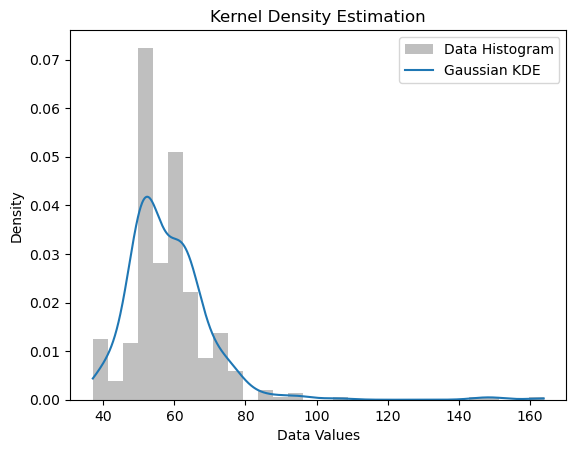

vertical_threshold value: 52.39393939393939


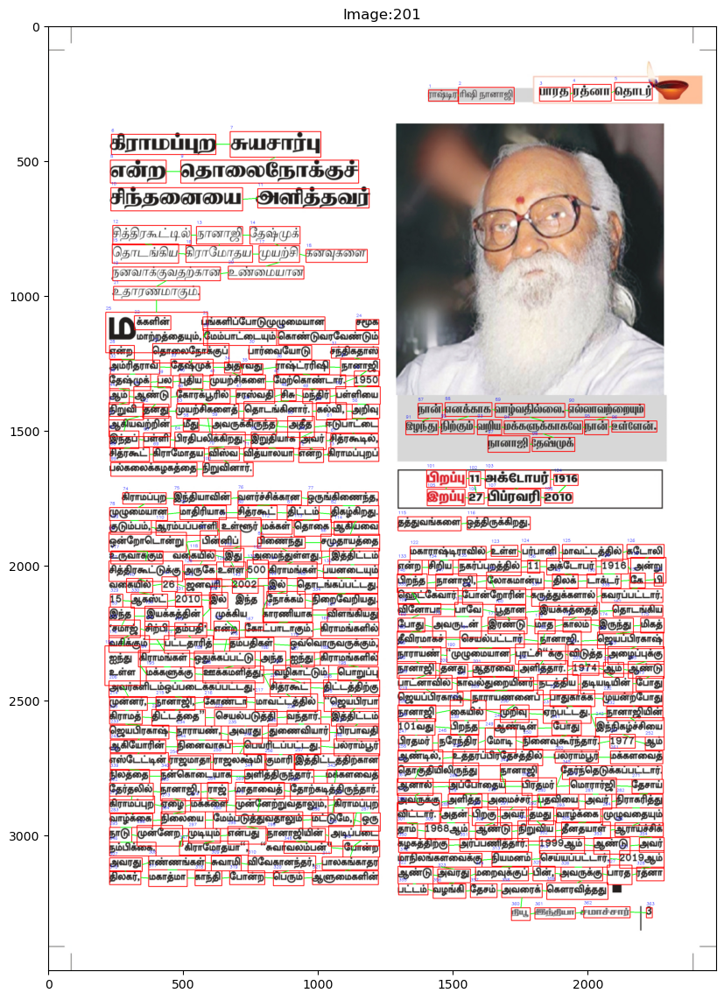

Hyper parameter: box


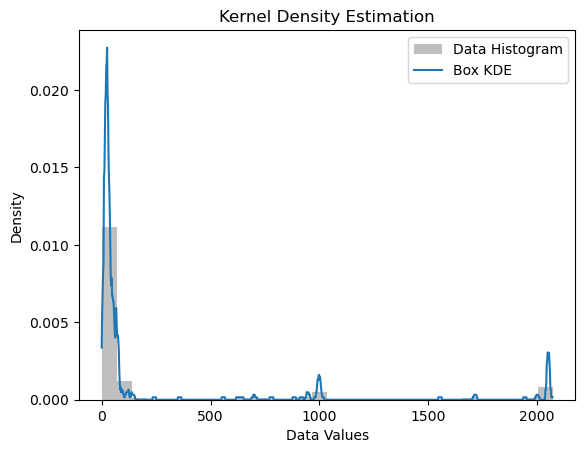

horizontal_threshold value: 20.92929292929293


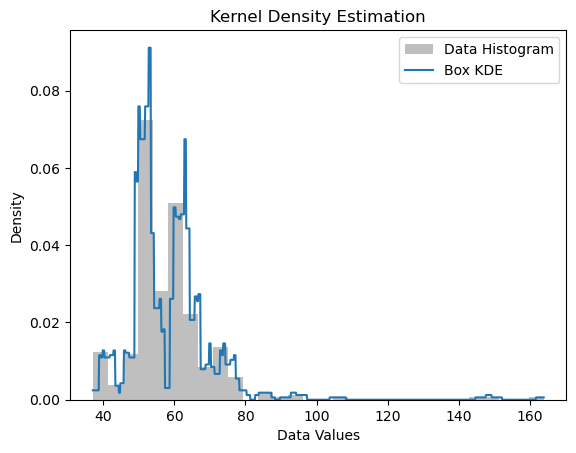

vertical_threshold value: 49.82828282828283


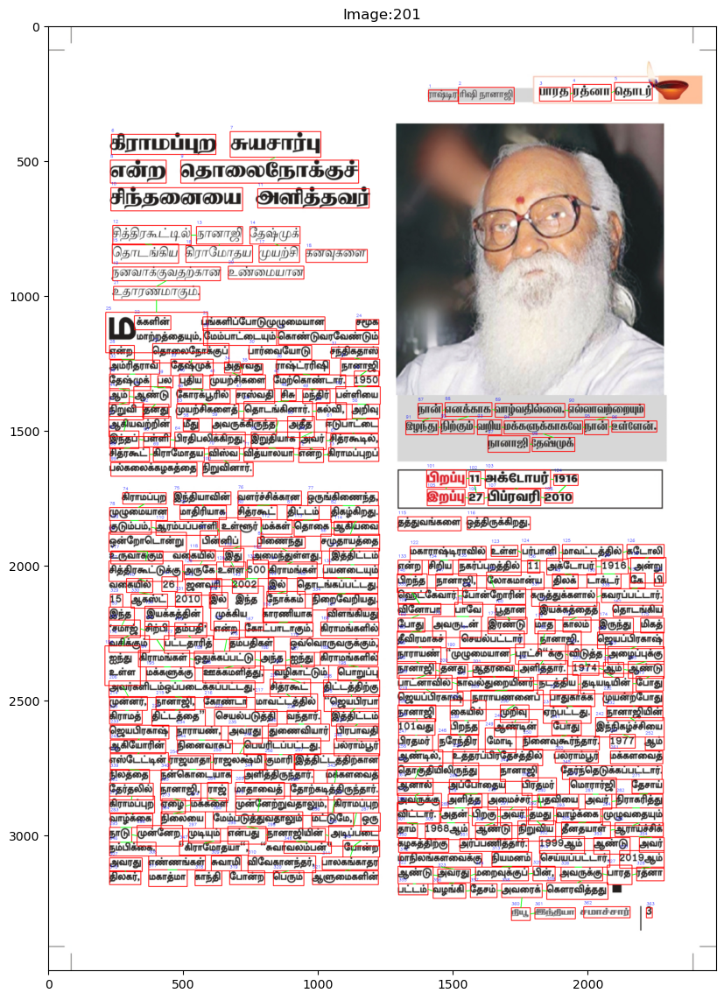

Hyper parameter: triangular


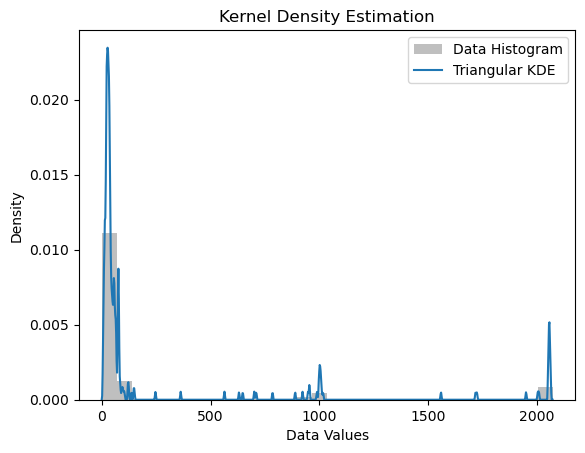

horizontal_threshold value: 20.92929292929293


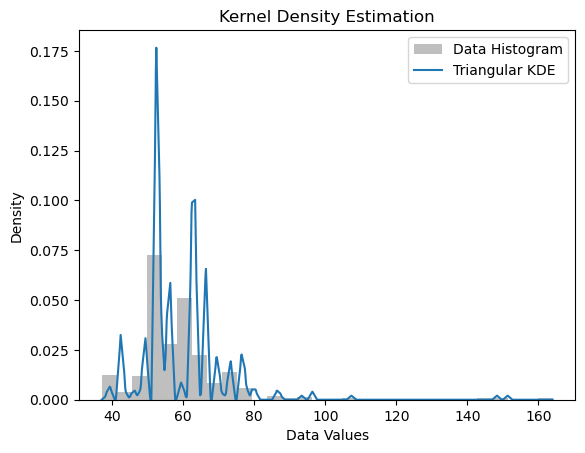

vertical_threshold value: 52.39393939393939


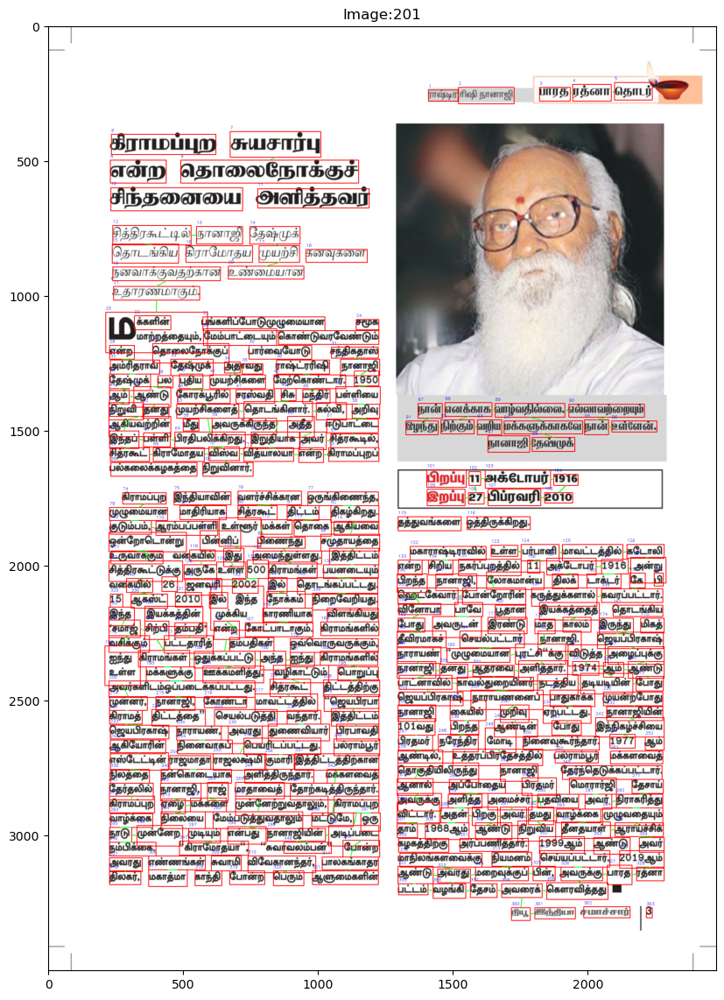

----------------------Image-232-------------------------
Hyper parameter: gaussian


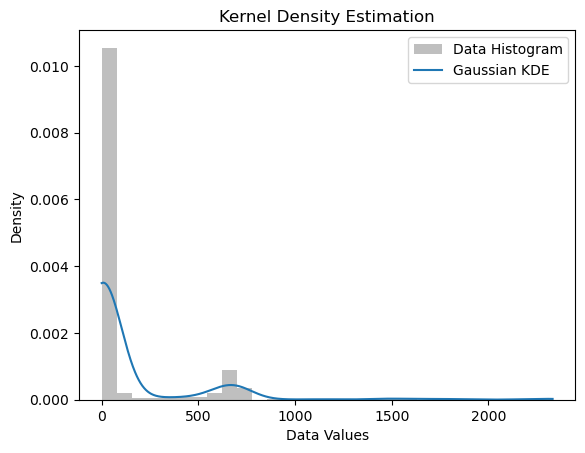

horizontal_threshold value: 47.111111111111114


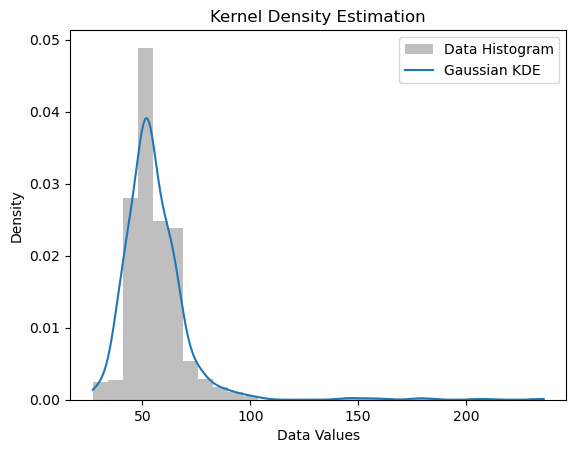

vertical_threshold value: 52.333333333333336


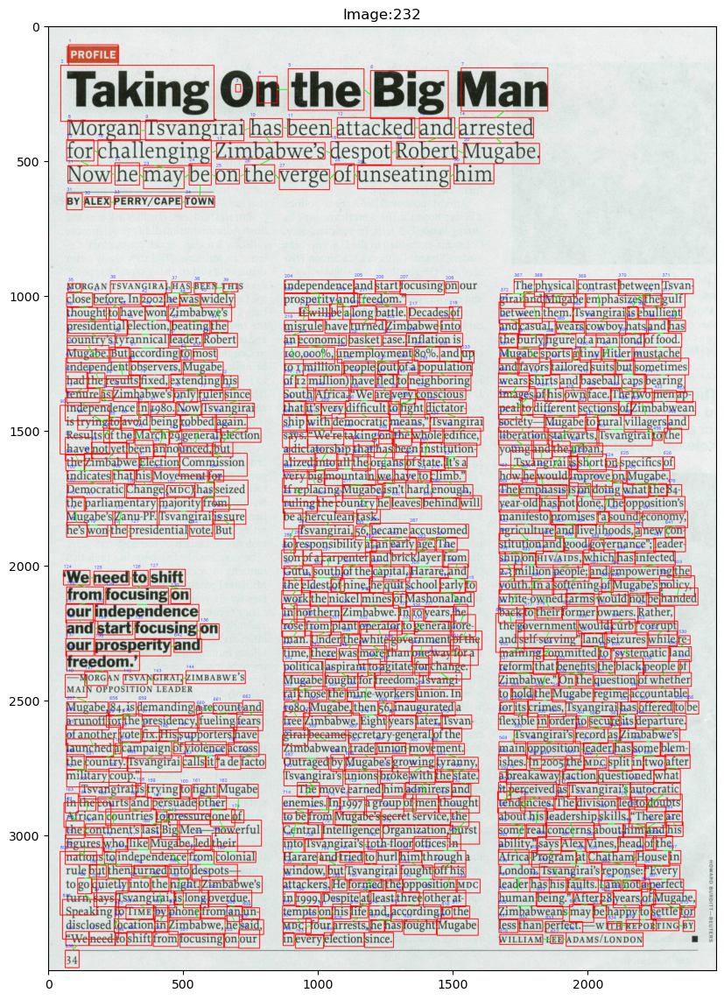

Hyper parameter: box


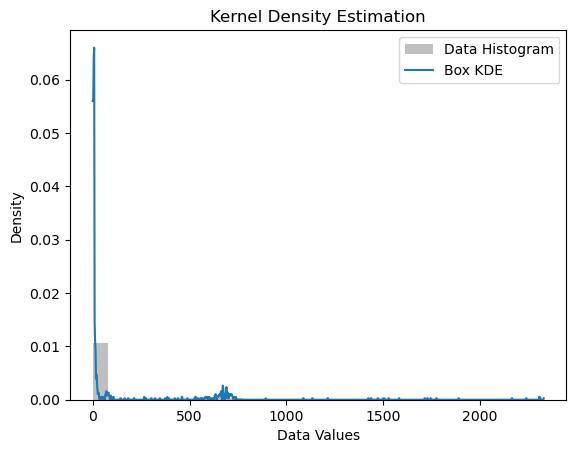

horizontal_threshold value: 23.555555555555557


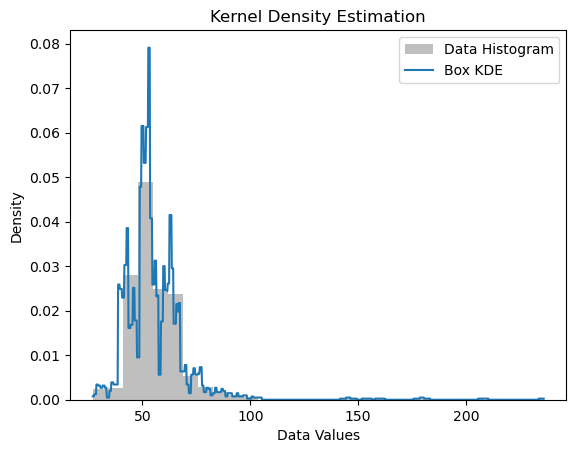

vertical_threshold value: 50.22222222222222


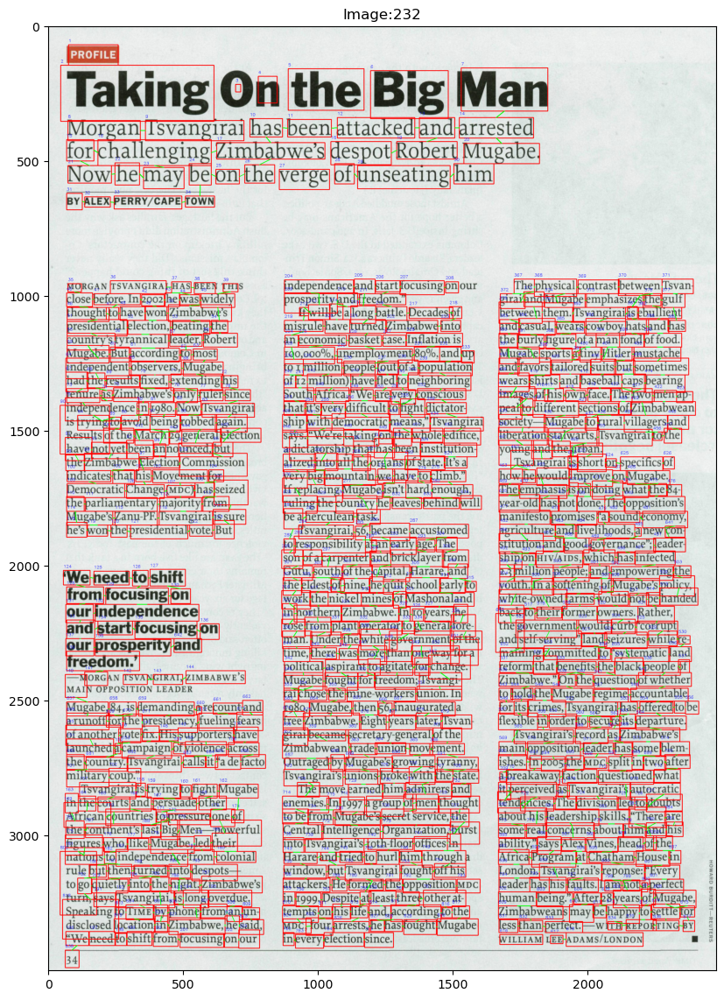

Hyper parameter: triangular


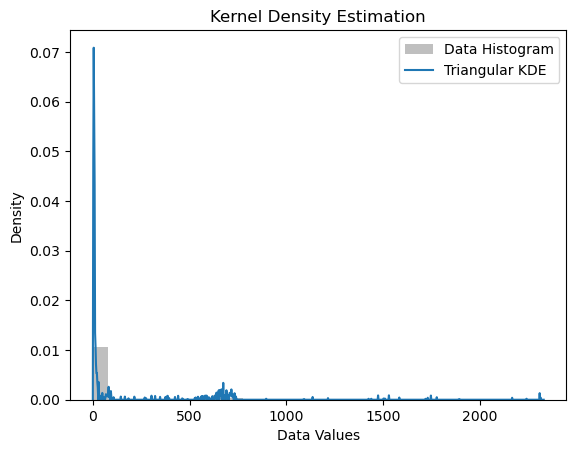

horizontal_threshold value: 23.555555555555557


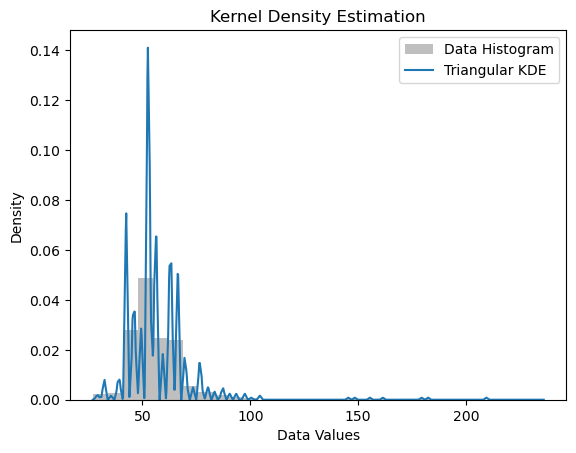

vertical_threshold value: 52.333333333333336


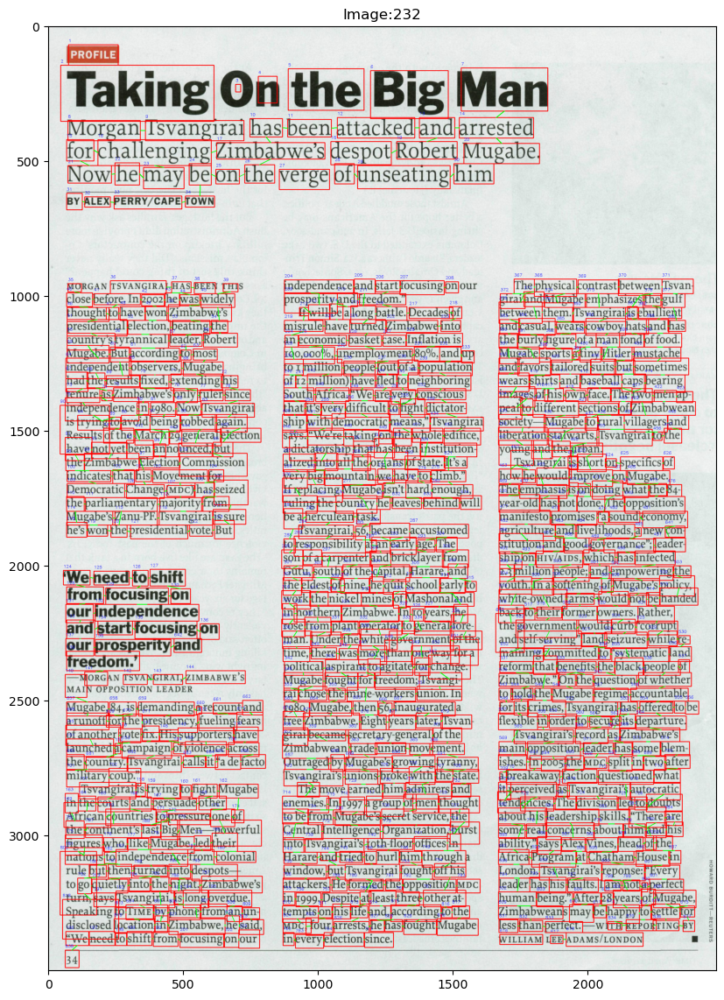

----------------------Image-250-------------------------
Hyper parameter: gaussian


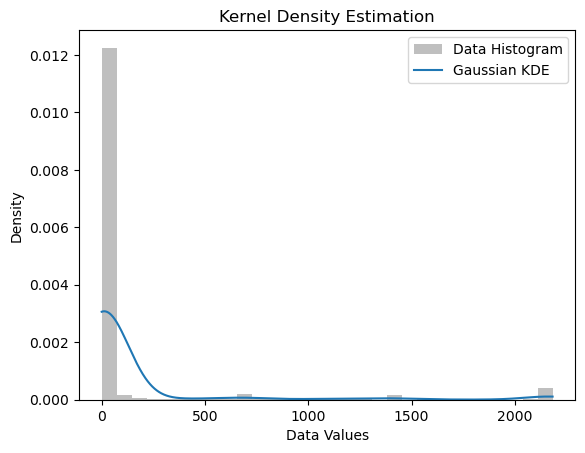

horizontal_threshold value: 44.101010101010104


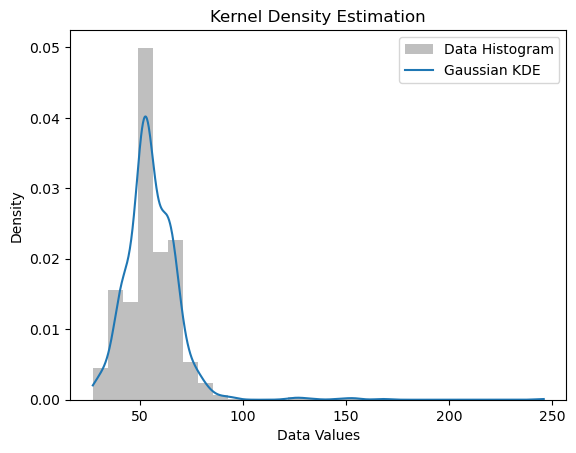

vertical_threshold value: 53.54545454545455


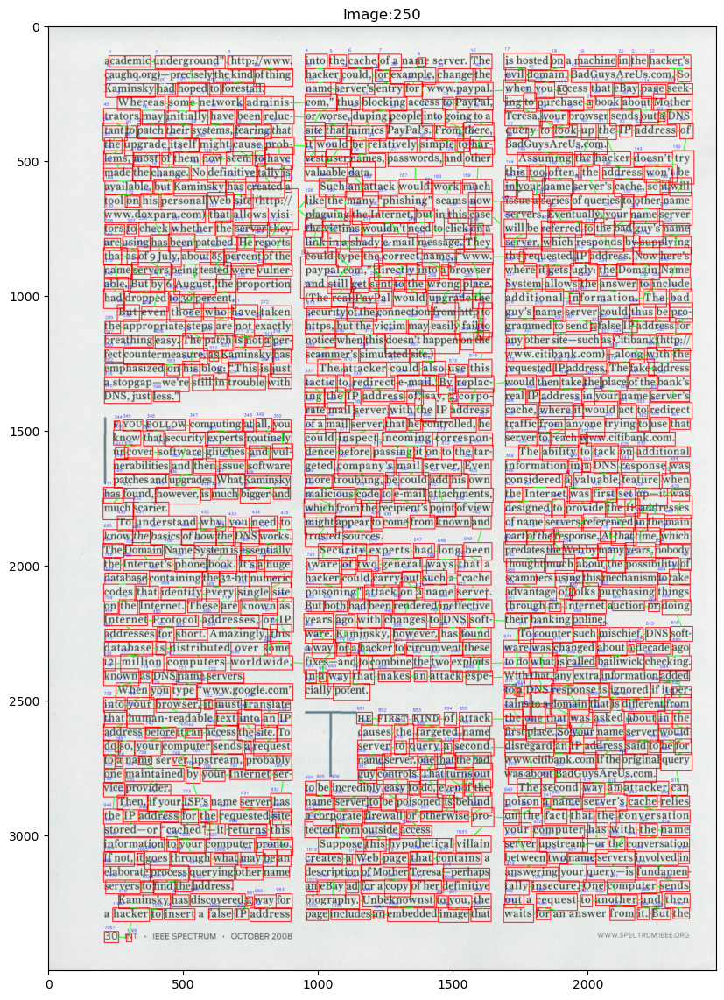

Hyper parameter: box


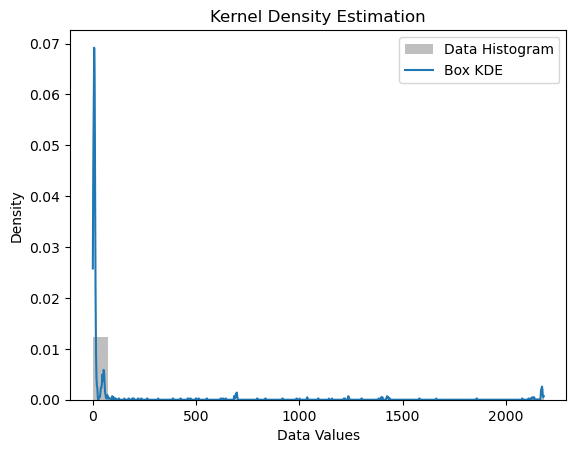

horizontal_threshold value: 22.050505050505052


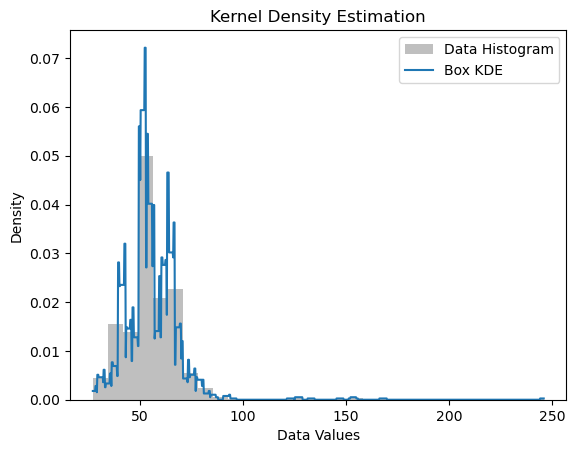

vertical_threshold value: 51.33333333333333


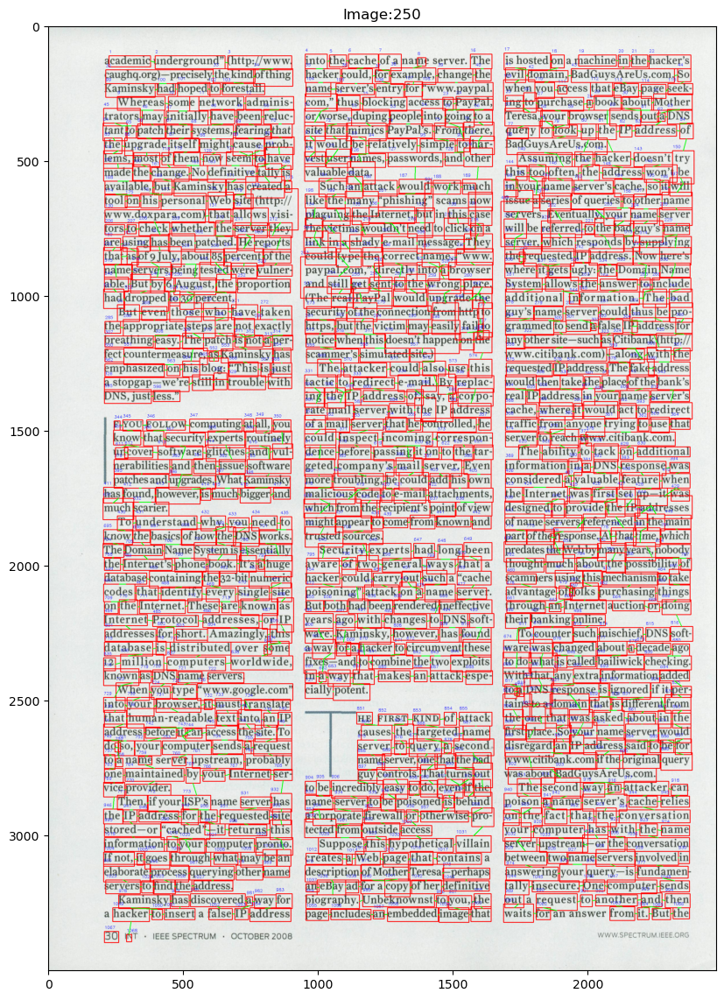

Hyper parameter: triangular


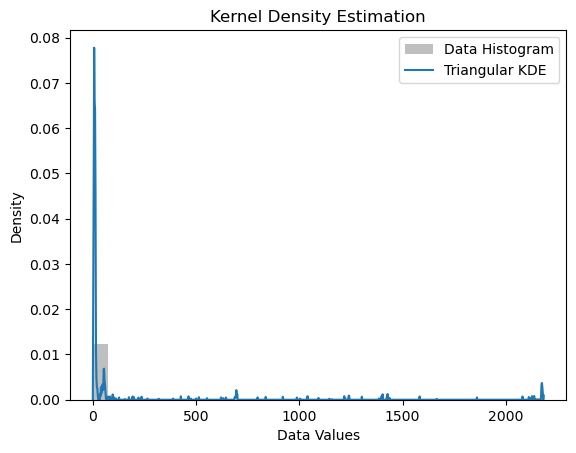

horizontal_threshold value: 22.050505050505052


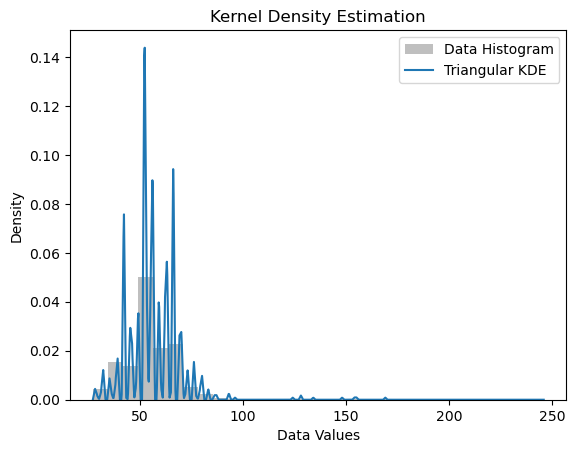

vertical_threshold value: 55.75757575757575


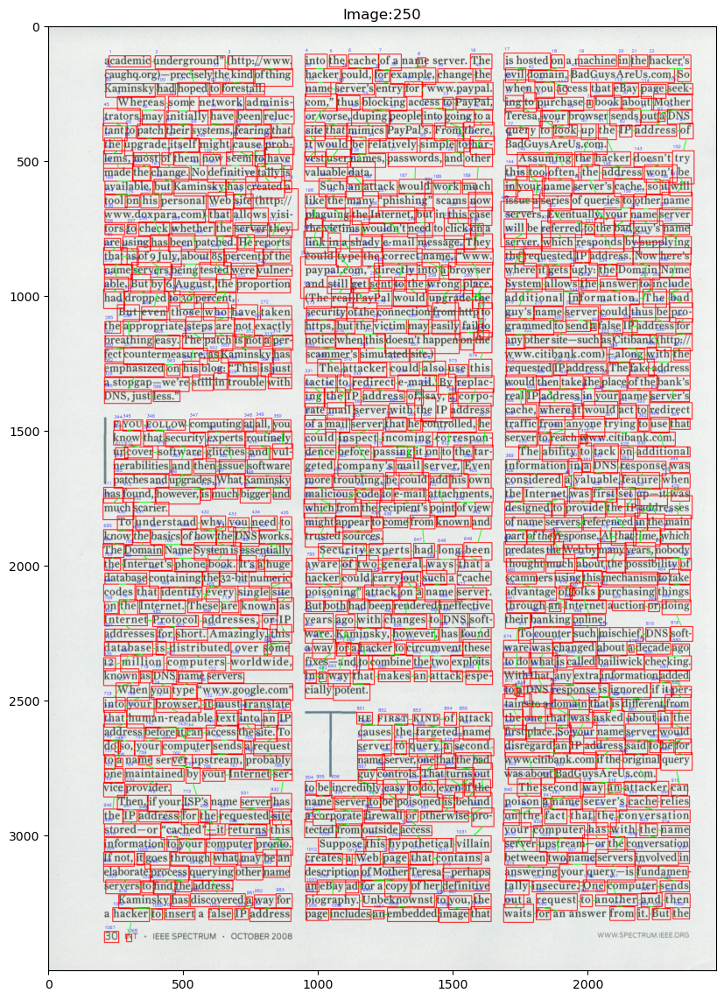

In [44]:
horizontal_thresholds = []
vertical_thresholds = []
Hyper_param = ['gaussian', 'box', 'triangular']
for image in [29,68,145,201,232,250]:
    print(f"----------------------Image-{image}-------------------------")
    df = pd.read_csv(f"SMAI - AQ2/CSV/TLBR_{image}.csv")
    euclidean_df = generate_euclidean_dataframe(df, horizontal_threshold=100, vertical_threshold=60)
    horizontal_data = []
    vertical_data = []
    for i in range(1,len(euclidean_df["Top-Edge-Center"])):
        a = np.absolute(euclidean_df["Left-Edge-Center"][i][0] - euclidean_df["Right-Edge-Center"][i-1][0])
        b =  euclidean_df["Bottom-Edge-Center"][i][1] - euclidean_df["Top-Edge-Center"][i][1]
        
        horizontal_data.append(a)
        vertical_data.append(b)

    for j in Hyper_param:
        print("Hyper parameter:",j)    
        horizontal_threshold = calculate_kde_threshold(horizontal_data,kernel=j,horizontal_t = True)
        print("horizontal_threshold value:",horizontal_threshold)
        vertical_threshold = calculate_kde_threshold(vertical_data,kernel=j)
        print("vertical_threshold value:",vertical_threshold)
        horizontal_thresholds.append(horizontal_threshold)
        vertical_thresholds.append(vertical_threshold)
        img = cv2.imread(f'SMAI - AQ2/images/{image}.jpg')
        df_ = pd.read_csv(f"SMAI - AQ2/CSV/TLBR_{image}.csv")

        euclidean_df_n = generate_euclidean_dataframe(df_, horizontal_threshold, vertical_threshold)
        plt.figure(figsize=(20, 14))
        plt.imshow(make_connections(img,euclidean_df_n))
        plt.title(f"Image:{image}")
        plt.show()

Visualize and compare the generated output for the following images given by
your KDE with the best hyperparameter configuration with the output obtained
from your solution in Assignment 2 Question 4.2. The images are listed below :<br>
• 29.jpg<br>
• 68.jpg<br>
• 145.jpg<br>
• 201.jpg<br>
• 232.jpg<br>
• 250.jpg



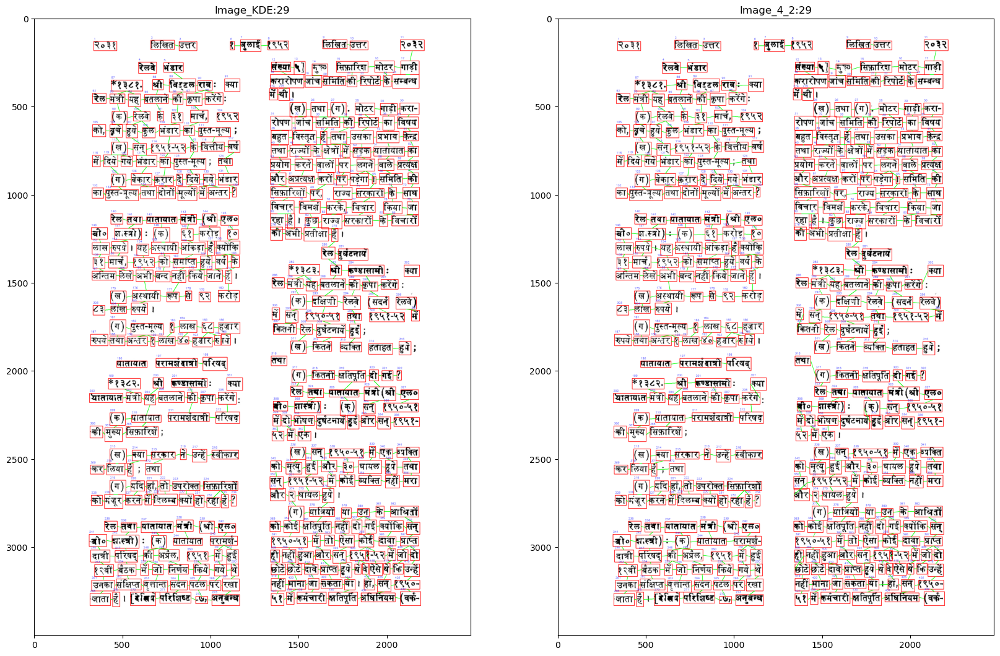

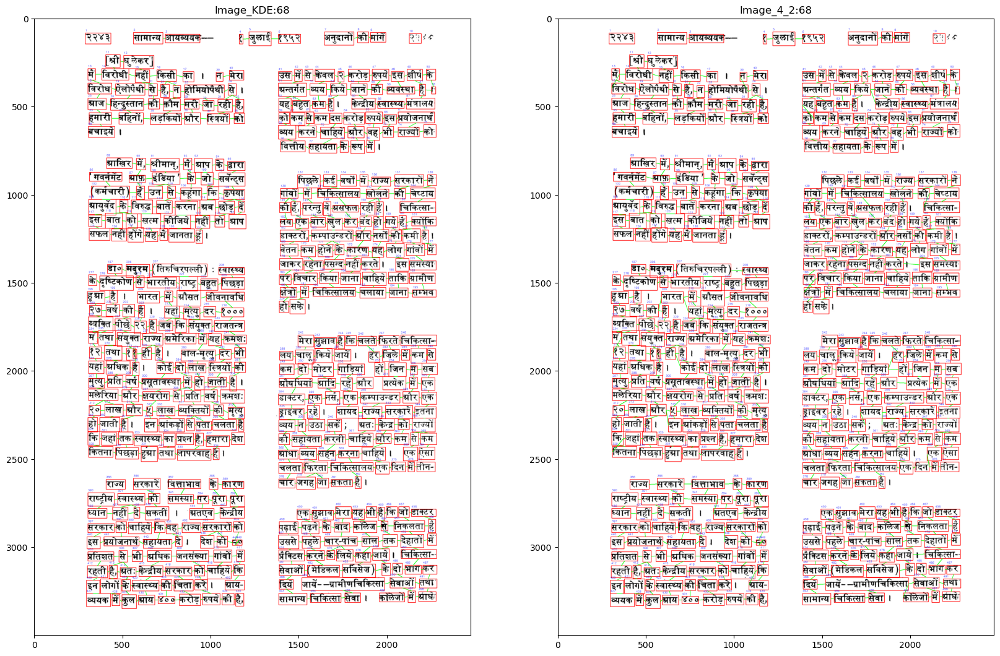

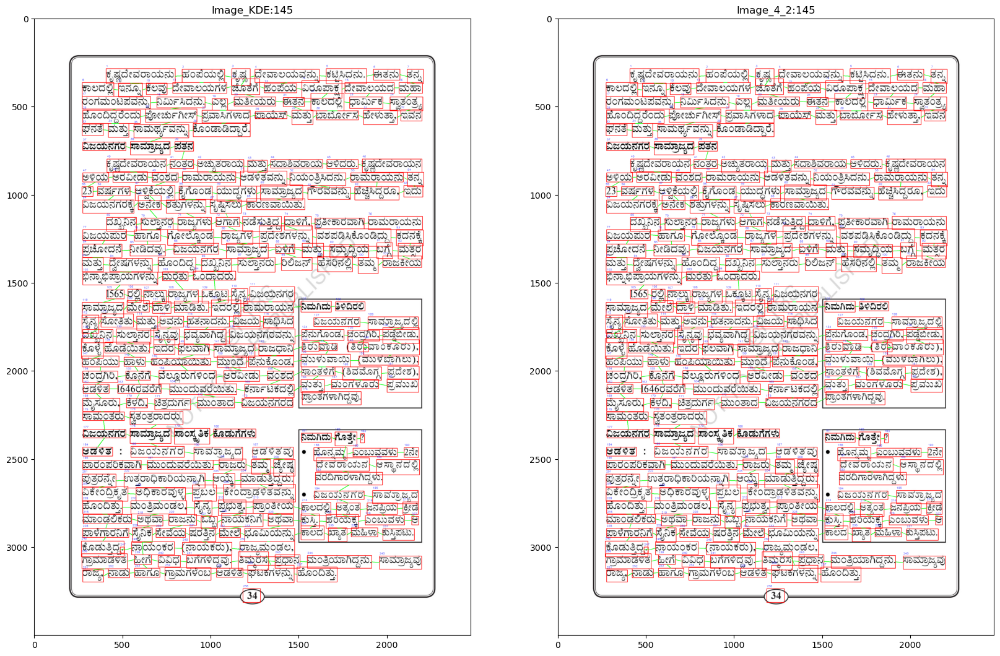

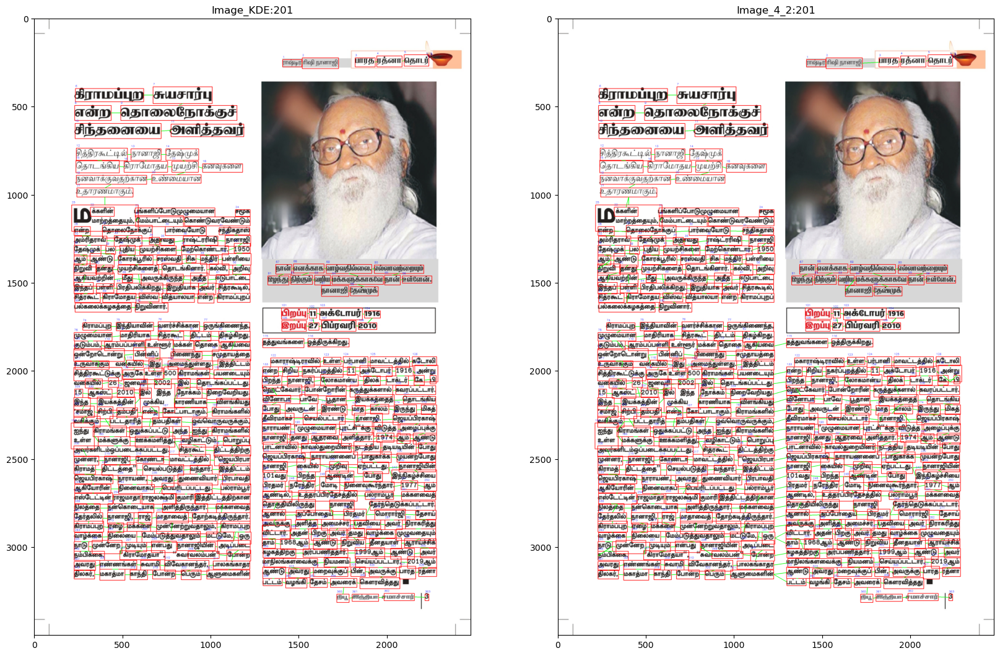

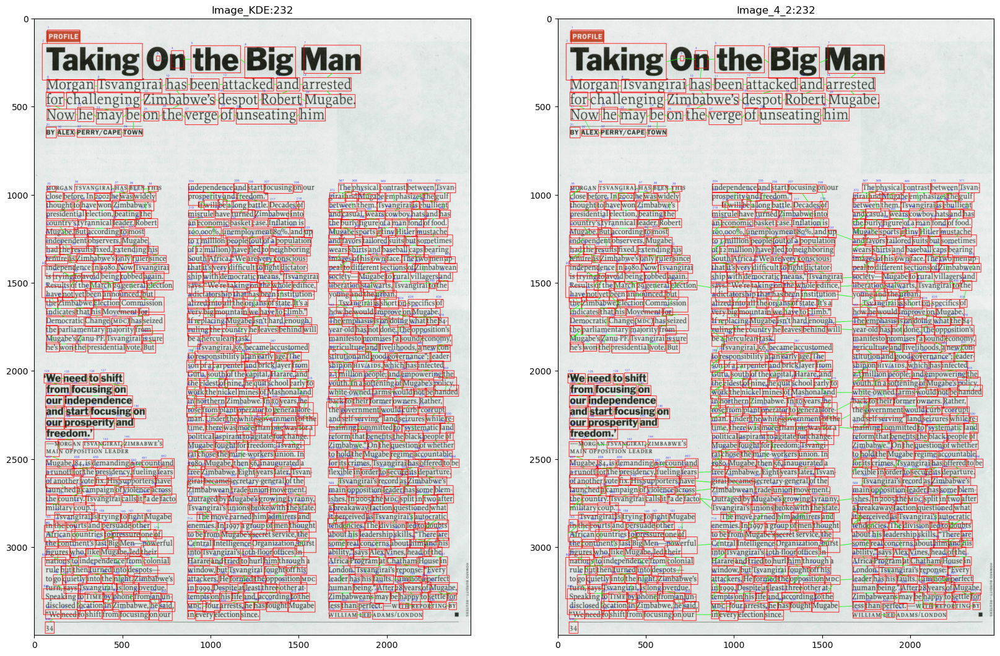

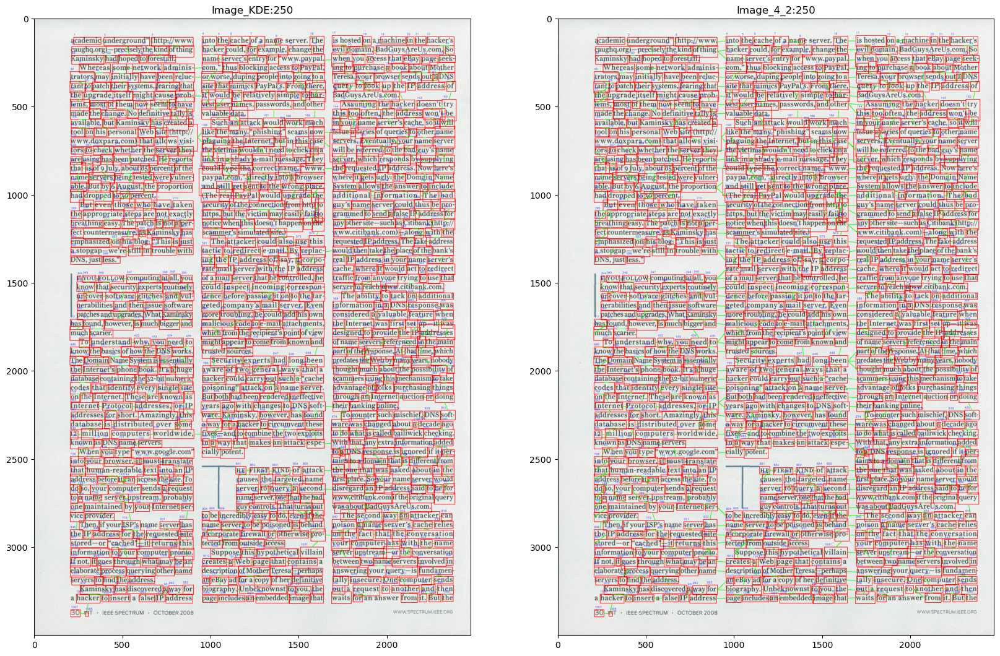

In [46]:
horizontal_threshold_KDE = [39.4,42,58,62,47.5,44]
vertical_threshold_KDE = [64.8, 64.4,75,52,52,53]

horizontal_threshold_4_2 = 100
vertical_threshold_4_2 = 60

for i,image in enumerate([29,68,145,201,232,250]):
    img = cv2.imread(f'SMAI - AQ2/images/{image}.jpg')
    df_ = pd.read_csv(f"SMAI - AQ2/CSV/TLBR_{image}.csv")

    euclidean_df_KDE = generate_euclidean_dataframe(df_, horizontal_threshold_KDE[i], vertical_threshold_KDE[i])
    plt.figure(figsize=(20, 14))
    plt.subplot(1,2,1)
    plt.imshow(make_connections(img,euclidean_df_KDE))
    plt.title(f"Image_KDE:{image}")

    euclidean_df_n_4_2 = generate_euclidean_dataframe(df_, horizontal_threshold_4_2, vertical_threshold_4_2)
    plt.subplot(1,2,2)
    plt.imshow(make_connections(img,euclidean_df_n_4_2))
    plt.title(f"Image_4_2:{image}")
    plt.show()
